-----
# 1. 필요 라이브러리 불러오기
-----

In [42]:
import os
import urllib
import cv2
import numpy as np
from matplotlib import pyplot as plt


-----
# 2. ml4a 설치
-----

구글 코랩에서는 pixellib이 설치가 되지 않아서 대용으로 ml4a를 찾게 되었고 해당 모델을 설치 한 후 진행을 하려 한다.

In [18]:
%tensorflow_version 1.x
!pip3 install --quiet ml4a

TensorFlow 1.x selected.
     |████████████████████████████████| 1.1 MB 8.5 MB/s 
     |████████████████████████████████| 108 kB 71.5 MB/s 
     |████████████████████████████████| 561 kB 78.4 MB/s 
     |████████████████████████████████| 132 kB 86.9 MB/s 
     |████████████████████████████████| 235 kB 80.0 MB/s 
     |████████████████████████████████| 596 kB 71.1 MB/s 
     |████████████████████████████████| 140 kB 73.9 MB/s 
     |████████████████████████████████| 5.8 MB 66.0 MB/s 
     |████████████████████████████████| 829 kB 62.3 MB/s 
     |████████████████████████████████| 722 kB 61.9 MB/s 
     |████████████████████████████████| 100.1 MB 80.4 MB/s 


In [19]:
from ml4a import image
from ml4a.models import semantic_segmentation

print(semantic_segmentation.classes)

Imageio: 'ffmpeg-linux64-v3.3.1' was not found on your computer; downloading it now.
Try 1. Download from https://github.com/imageio/imageio-binaries/raw/master/ffmpeg/ffmpeg-linux64-v3.3.1 (43.8 MB)
Downloading: 8192/45929032 bytes (0.0%)3743744/45929032 bytes (8.2%)8044544/45929032 bytes (17.5%)12345344/45929032 bytes (26.9%)16556032/45929032 bytes (36.0%)20815872/45929032 bytes (45.3%)24985600/45929032 bytes (54.4%)29024256/45929032 bytes (63.2%)33308672/45929032 bytes (72.5%)37543936/45929032 bytes (81.7%)41779200/45929032 bytes (91.0%)45929032/45929032 bytes (100.0%)
  Done
File saved as /root/.imageio/ffmpeg/ffmpeg-linux64-v3.3.1.
{0: 'wall', 1: 'buildi

-----
# 3. 이미지 불러오기
-----

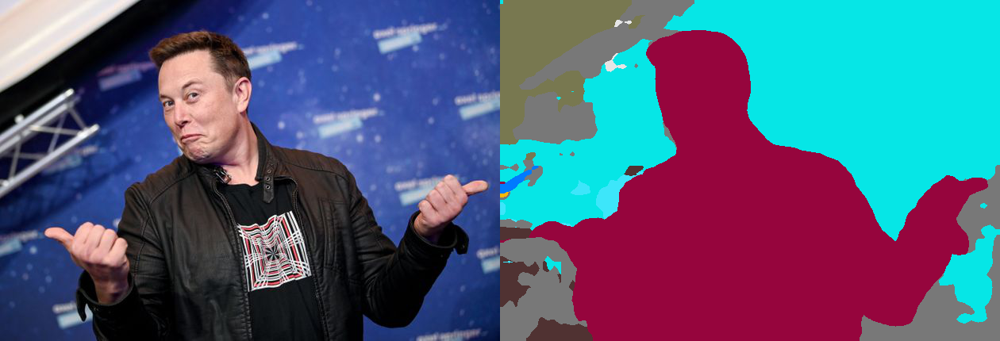

In [46]:
img = image.load_image('/content/drive/MyDrive/aiffel/EXP 10/person.jpeg')
labels = semantic_segmentation.run(img)
semantic_segmentation.visualize(img, labels)

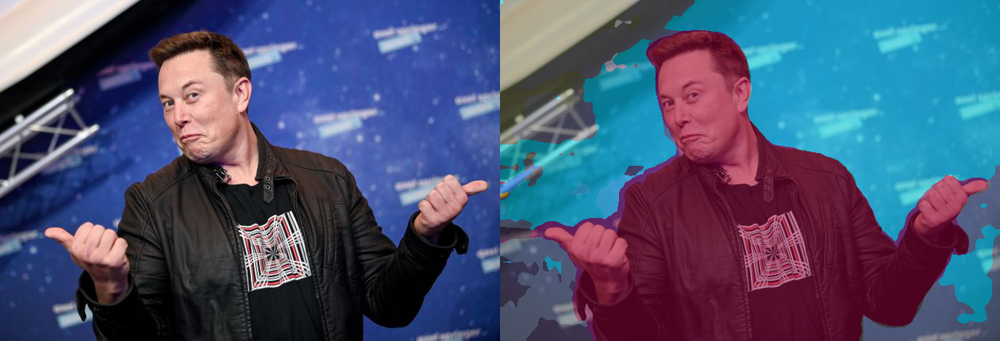

In [27]:
labels = semantic_segmentation.run(img)
color_labels = semantic_segmentation.get_color_labels(labels)
image.display([img, 0.5 * np.array(img) + 0.5 * color_labels])

1: person


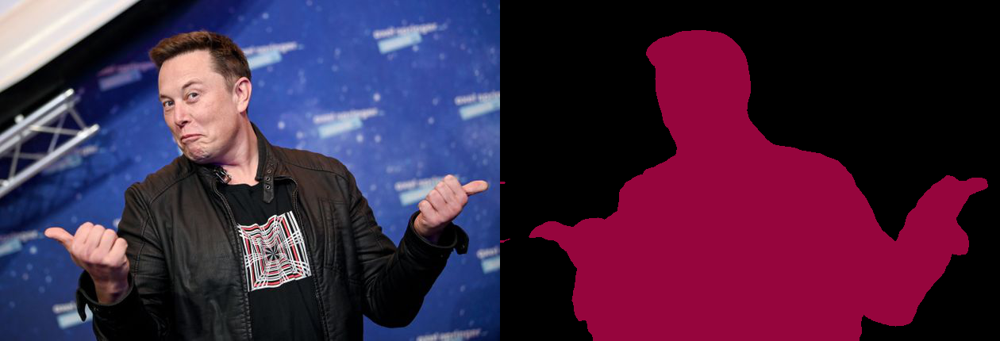

2: sky


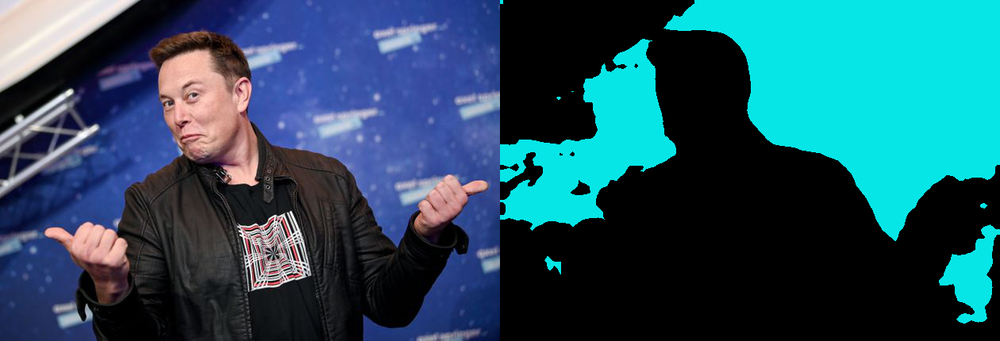

3: wall


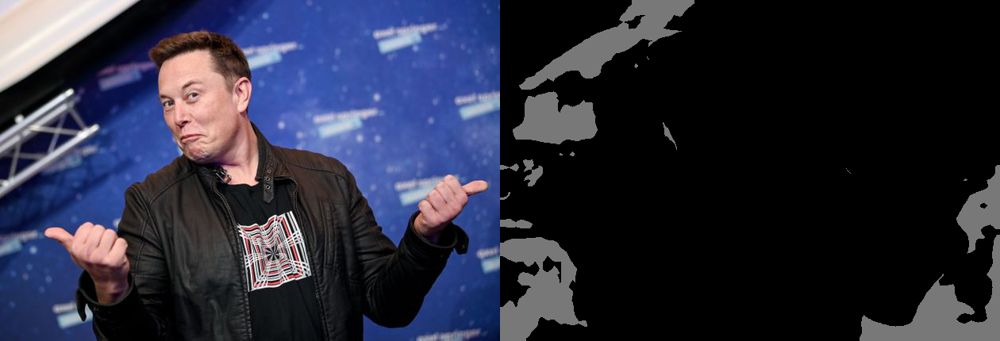

In [28]:
top_classes = np.bincount(labels.flatten()).argsort()[::-1]
for c, top_class in enumerate(top_classes[:3]):
    class_name = semantic_segmentation.classes[top_class]
    print('%d: %s' % (c+1, class_name))
    semantic_segmentation.visualize(img, labels, top_class)

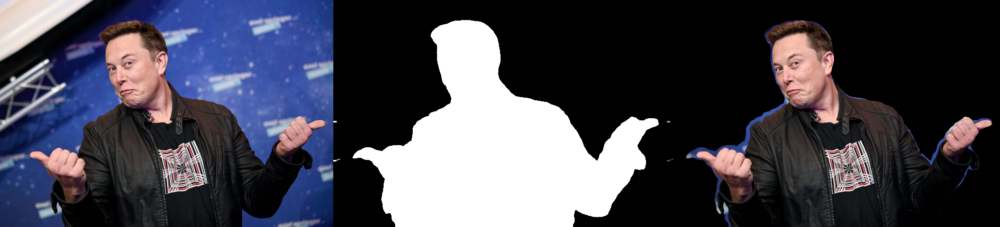

In [29]:
from ml4a.canvas import mask

person_mask = semantic_segmentation.get_mask(labels, index='person')
img_masked = mask.mask_image(person_mask, img)

all_images = image.concatenate_images([img, person_mask, img_masked])
image.display(all_images)

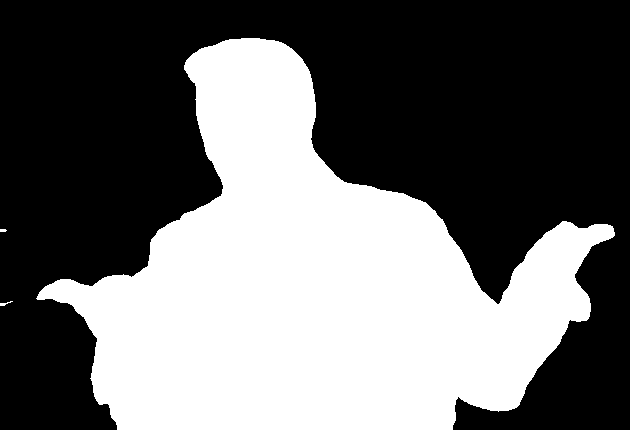

In [33]:
image.display(person_mask)

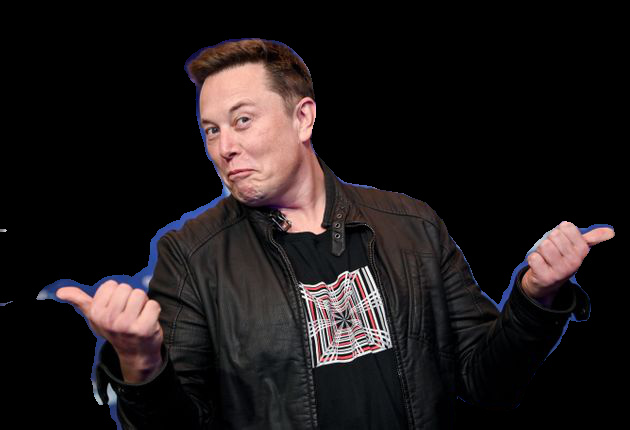

In [34]:
image.display(img_masked)

(430, 630, 3)


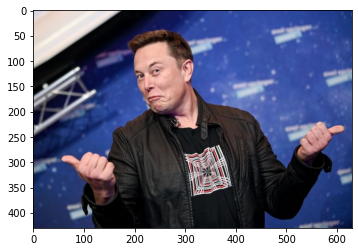

In [49]:
img_path = '/content/drive/MyDrive/aiffel/EXP 10/person.jpeg'  
img_orig = cv2.imread(img_path) 

print(img_orig.shape)
plt.imshow(cv2.cvtColor(img_orig, cv2.COLOR_BGR2RGB))
plt.show()

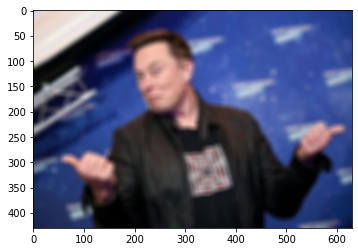

In [50]:
# (13,13)은 blurring kernel size를 뜻합니다
# 다양하게 바꿔보세요
img_orig_blur = cv2.blur(img_orig, (13,13))  
plt.imshow(cv2.cvtColor(img_orig_blur, cv2.COLOR_BGR2RGB))
plt.show()

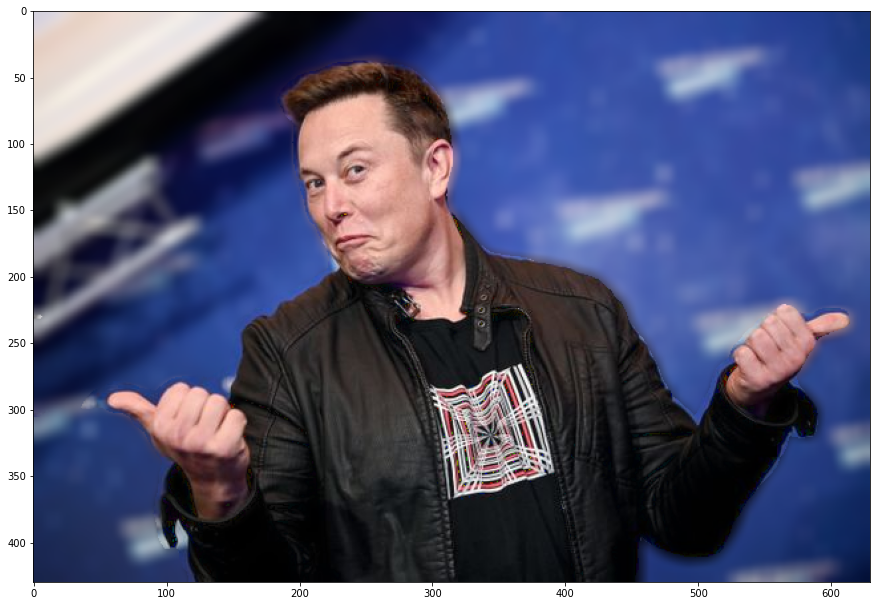

In [89]:
img_concat = np.where(img_masked, img_orig, img_orig_blur)
img_result = cv2.cvtColor(img_concat, cv2.COLOR_BGR2RGB)

plt.figure(figsize = (15,15))
plt.imshow(img_result)
plt.show()

##### 출력시 이미지 크기 조정 코드 #####
# up_width = 1260
# up_height = 860
# up_points = (up_width, up_height)
# # resize the image
# resized_up = cv2.resize(img_result, up_points, interpolation=cv2.INTER_LINEAR)

-----
# 4. ml4a에 대한 이해도 높이기
------

In [94]:
print(semantic_segmentation.classes)

{0: 'wall', 1: 'building', 2: 'sky', 3: 'floor', 4: 'tree', 5: 'ceiling', 6: 'road', 7: 'bed', 8: 'windowpane', 9: 'grass', 10: 'cabinet', 11: 'sidewalk', 12: 'person', 13: 'earth', 14: 'door', 15: 'table', 16: 'mountain', 17: 'plant', 18: 'curtain', 19: 'chair', 20: 'car', 21: 'water', 22: 'painting', 23: 'sofa', 24: 'shelf', 25: 'house', 26: 'sea', 27: 'mirror', 28: 'rug', 29: 'field', 30: 'armchair', 31: 'seat', 32: 'fence', 33: 'desk', 34: 'rock', 35: 'wardrobe', 36: 'lamp', 37: 'bathtub', 38: 'railing', 39: 'cushion', 40: 'base', 41: 'box', 42: 'column', 43: 'signboard', 44: 'chest', 45: 'counter', 46: 'sand', 47: 'sink', 48: 'skyscraper', 49: 'fireplace', 50: 'refrigerator', 51: 'grandstand', 52: 'path', 53: 'stairs', 54: 'runway', 55: 'case', 56: 'pool', 57: 'pillow', 58: 'screen', 59: 'stairway', 60: 'river', 61: 'bridge', 62: 'bookcase', 63: 'blind', 64: 'coffee', 65: 'toilet', 66: 'flower', 67: 'book', 68: 'hill', 69: 'bench', 70: 'countertop', 71: 'stove', 72: 'palm', 73: 'k

해당 클래스를 보면 모델이 인식할 수 있는 라벨들이 딕셔너리 형태로 나와있다.  
위에 있는 클래스별 이미지의 인식들을 보면 person / sky / wall이 있다.  
해당 라벨들을 index로 지정해서 이미지를 뽑아보겠다.

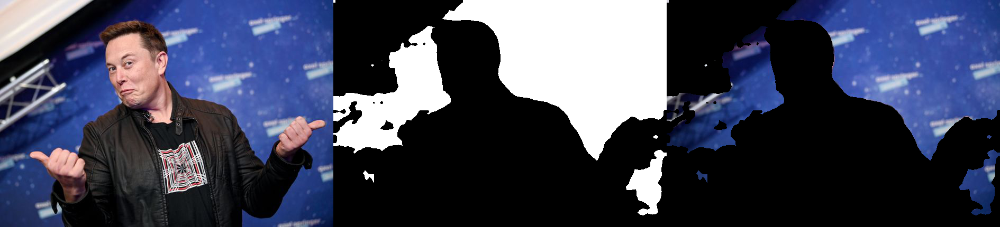

In [95]:
test_sky = semantic_segmentation.get_mask(labels, index='sky')
test_sky_mask = mask.mask_image(test_sky, img)

image_test_sky = image.concatenate_images([img, test_sky, test_sky_mask])
image.display(image_test_sky)

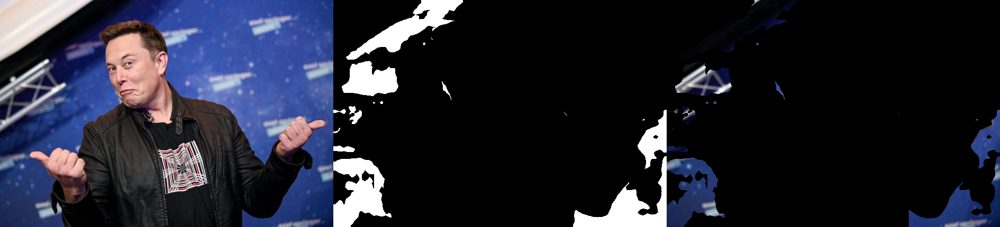

In [96]:
test_wall = semantic_segmentation.get_mask(labels, index='wall')
test_wall_mask = mask.mask_image(test_wall, img)

image_test_wall = image.concatenate_images([img, test_wall, test_wall_mask])
image.display(image_test_wall)

index값만 바꿔주면 모델이 알아서 이미지의 라벨을 분류하고 누끼를 따준다.  
물론 정확하게 분리를 해주는 것은 아니지만 간단하게 활용하기에는 충분히 좋은 모델이라고 생각이 든다.

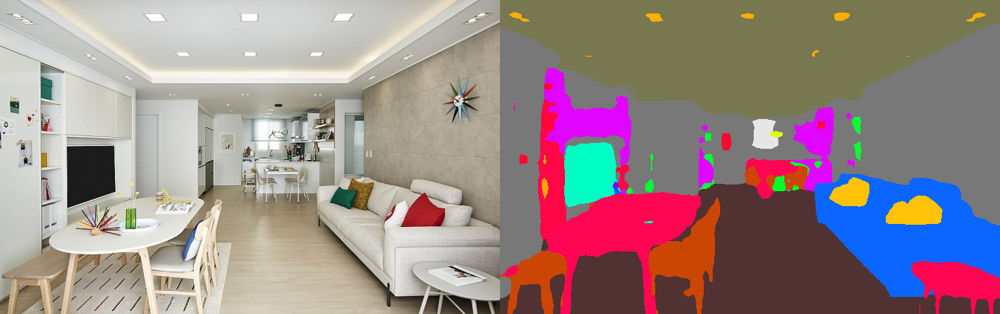

In [137]:
img_home = image.load_image('/content/drive/MyDrive/aiffel/EXP 10/home.jpg')
labels_home = semantic_segmentation.run(img_home)
semantic_segmentation.visualize(img_home, labels_home )

In [139]:
top_classes_home = np.bincount(labels_home.flatten()).argsort()[::-1]
for c, top_class in enumerate(top_classes_home[:10]):
    class_name = semantic_segmentation.classes[top_class]
    print('%d: %s' % (c+1, class_name))
    semantic_segmentation.visualize(img_home, labels_home, top_class)

Output hidden; open in https://colab.research.google.com to view.

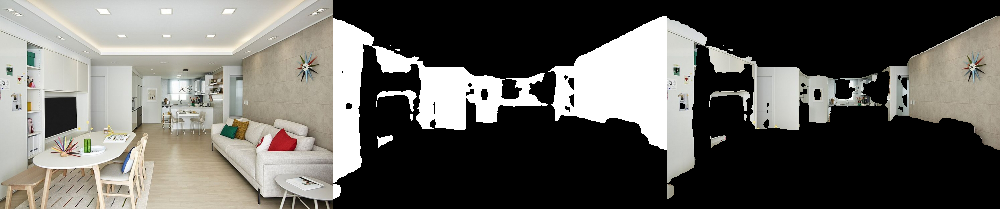

In [141]:
home_mask_wall = semantic_segmentation.get_mask(labels_home, index='wall')
home_wall_masked = mask.mask_image(home_mask_wall, img_home)

home_wall = image.concatenate_images([img_home, home_mask_wall, home_wall_masked])
image.display(home_wall)

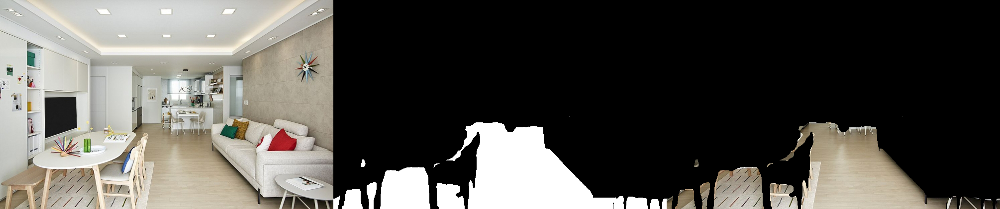

In [142]:
home_mask_floor = semantic_segmentation.get_mask(labels_home, index='floor')
home_floor_masked = mask.mask_image(home_mask_floor, img_home)

home_floor = image.concatenate_images([img_home, home_mask_floor, home_floor_masked])
image.display(home_floor)

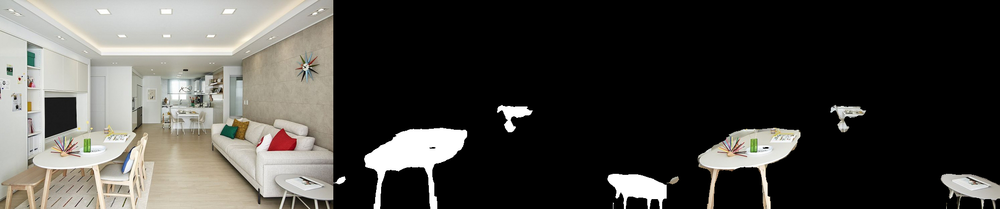

In [143]:
home_mask_table = semantic_segmentation.get_mask(labels_home, index='table')
home_table_masked = mask.mask_image(home_mask_table, img_home)

home_table = image.concatenate_images([img_home, home_mask_table, home_table_masked])
image.display(home_table)

class 내부의 라벨 내용도 가구 위주로 구성되어 있으며,   
실제로 확인해본 결과 명확하게 구분되지는 않지만 어느정도 가구를 인식하고 누끼를 따는 것을 볼 수 있다.

--------
# 5. 다른 이미지 활용해보기
-----

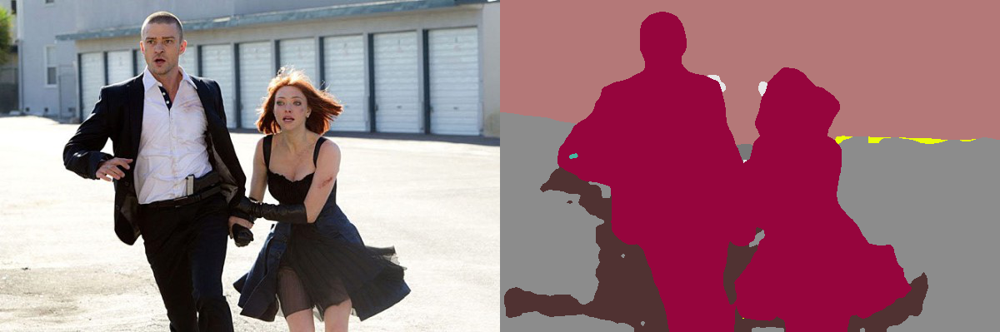

In [79]:
img2 = image.load_image('/content/drive/MyDrive/aiffel/EXP 10/person_2.jpg')
labels2 = semantic_segmentation.run(img2)
semantic_segmentation.visualize(img2, labels2)

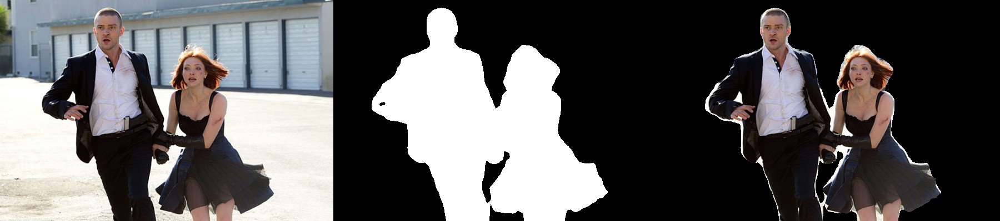

In [81]:
person_mask2 = semantic_segmentation.get_mask(labels2, index='person')
img_masked2 = mask.mask_image(person_mask2, img2)

all_images2 = image.concatenate_images([img2, person_mask2, img_masked2])
image.display(all_images2)

(399, 600, 3)


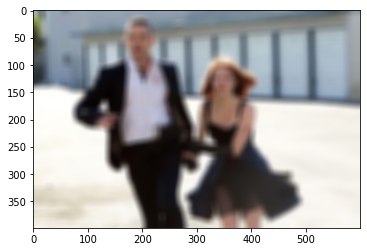

In [123]:
img_path2 = '/content/drive/MyDrive/aiffel/EXP 10/person_2.jpg'  
img_orig2 = cv2.imread(img_path2) 

print(img_orig2.shape)

img_orig_blur2 = cv2.blur(img_orig2, (15,15))  
plt.imshow(cv2.cvtColor(img_orig_blur2, cv2.COLOR_BGR2RGB))
plt.show()

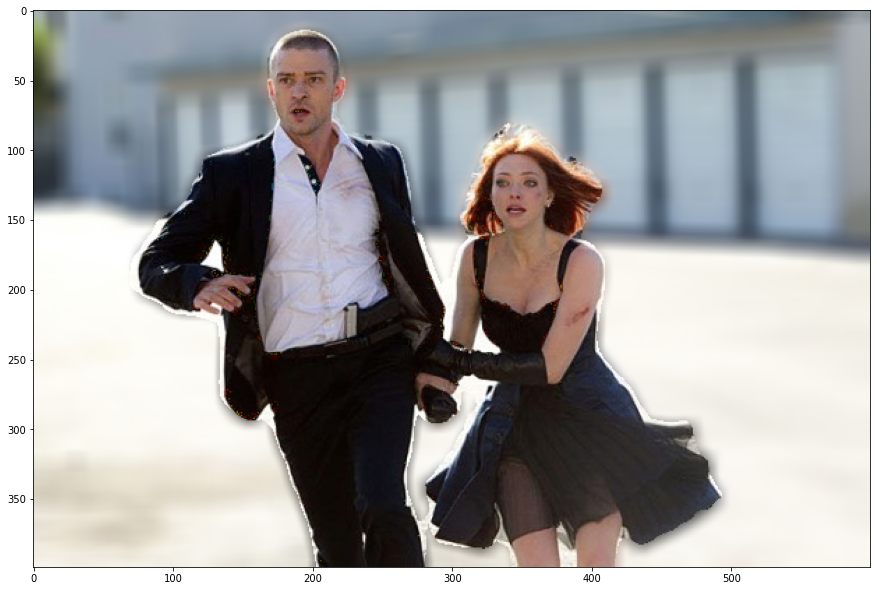

In [88]:
img_concat2 = np.where(img_masked2, img_orig2, img_orig_blur2)
img_result2 = cv2.cvtColor(img_concat2, cv2.COLOR_BGR2RGB)

plt.figure(figsize = (15,15))
plt.imshow(img_result2)
plt.show()


-----
# 6. 배경 바꾸기
-----

(792, 1408, 3)


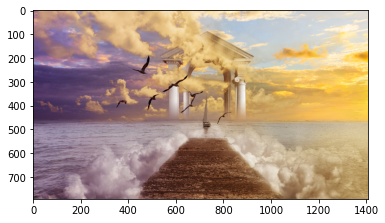

In [100]:
background = '/content/drive/MyDrive/aiffel/EXP 10/synthesis.jpg'  
img_background = cv2.imread(background) 
print(img_background.shape)

# plt.figure(figsize = (15,15))
plt.imshow(cv2.cvtColor(img_background, cv2.COLOR_BGR2RGB))
plt.show()

In [127]:
##### 출력시 이미지 크기 조정 코드 #####
up_width = 1408
up_height = 792
up_points = (up_width, up_height)
# resize the image
img_masked2_resize = cv2.resize(img_masked2 ,up_points, interpolation=cv2.INTER_LINEAR)
img_orig2_resize = cv2.resize(img_orig2 ,up_points, interpolation=cv2.INTER_LINEAR)

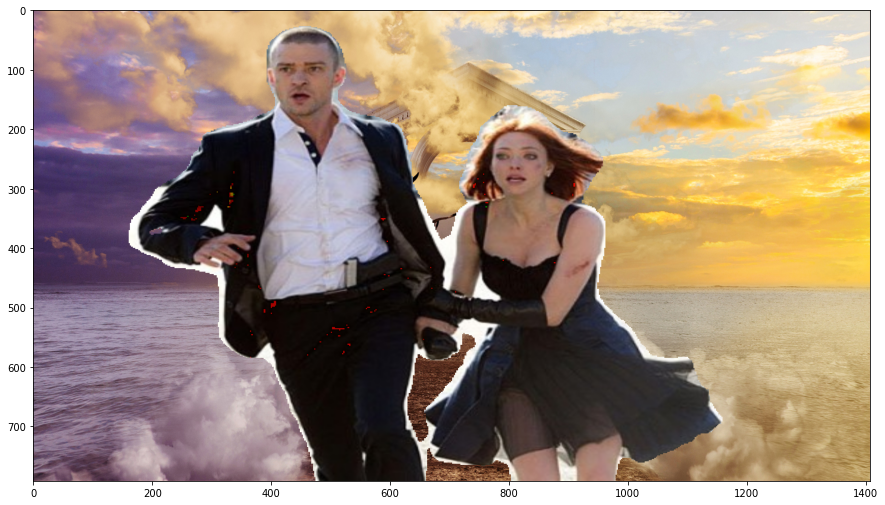

In [128]:
background_concat = np.where(img_masked2_resize, img_orig2_resize,img_background)
background_result = cv2.cvtColor(background_concat, cv2.COLOR_BGR2RGB)

plt.figure(figsize = (15,15))
plt.imshow(background_result)
plt.show()


-----
# 7. 고퀄리티 그림이미지와 저퀄리티 그림이미지 테스트
-----



2가지 그림 이미지를 불러와서   
해당 모델이 이미지를 인식해 classes의 라벨들로 표현할 수 있는지 확인해 보겠다.

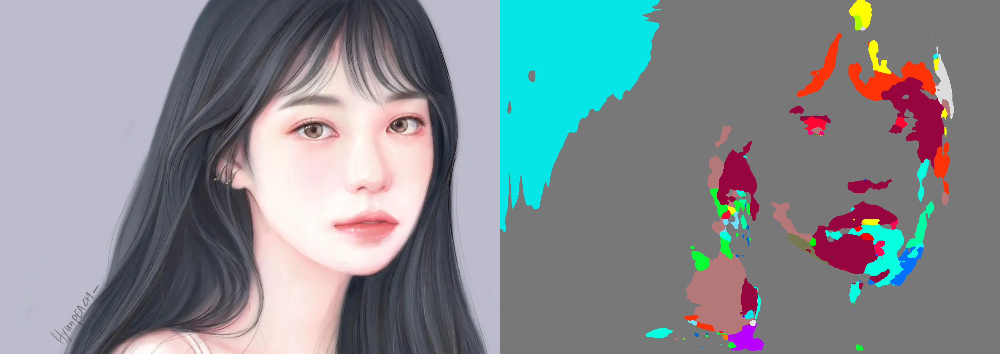

In [134]:
img3 = image.load_image('/content/drive/MyDrive/aiffel/EXP 10/draw_image.jpg')
labels3 = semantic_segmentation.run(img3)
semantic_segmentation.visualize(img3, labels3)

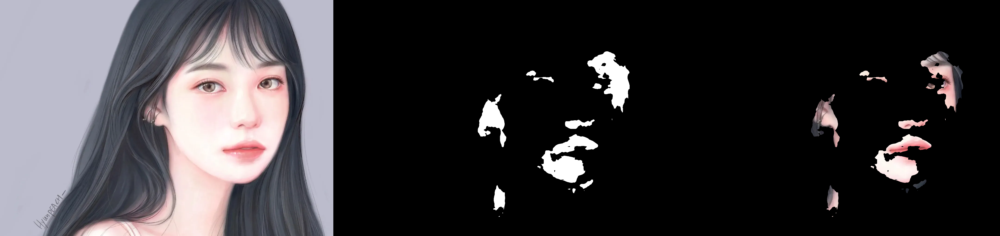

In [135]:
person_mask3 = semantic_segmentation.get_mask(labels3, index='person')
img_masked3 = mask.mask_image(person_mask3, img3)

all_images3 = image.concatenate_images([img3, person_mask3, img_masked3])
image.display(all_images3)

실제 사람과 같은 그림이미지를 불러와서 확인해 보았지만 모델이 인식을 못하는 것을 볼 수 있다.

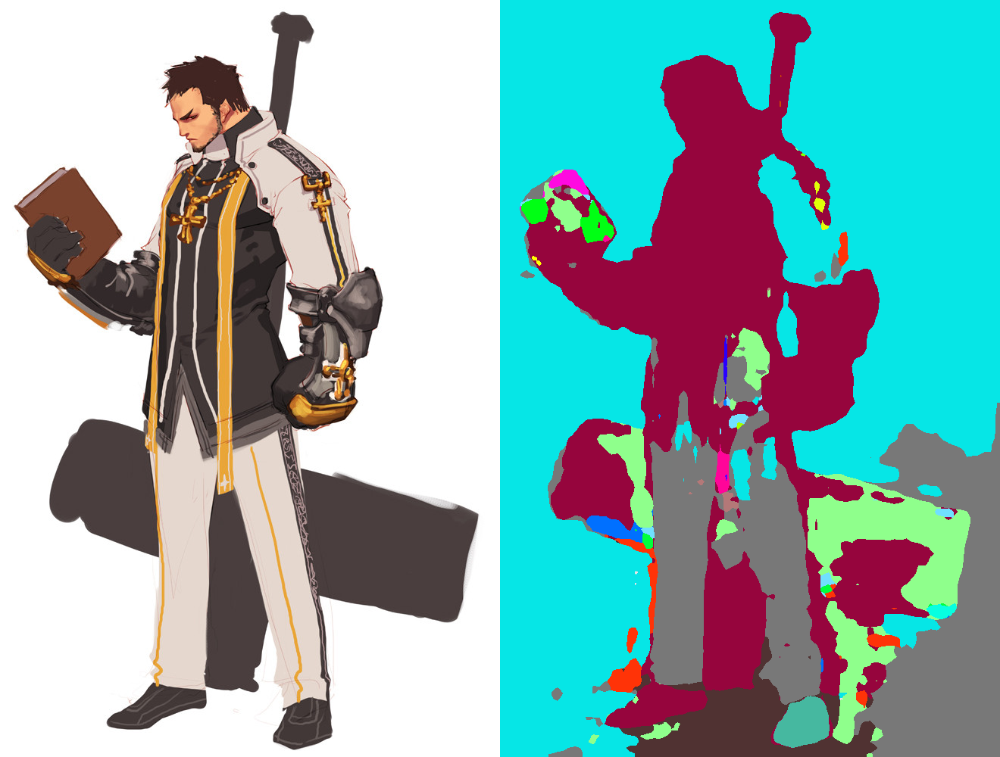

In [144]:
img5 = image.load_image('/content/drive/MyDrive/aiffel/EXP 10/draw_img.jpg')
labels5 = semantic_segmentation.run(img5)
semantic_segmentation.visualize(img5, labels5)

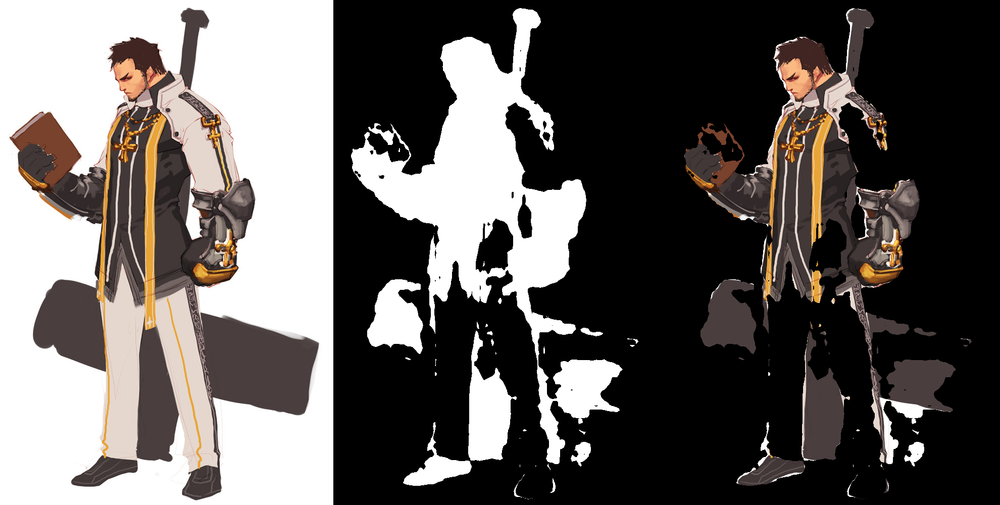

In [145]:
person_mask5 = semantic_segmentation.get_mask(labels5, index='person')
img_masked5 = mask.mask_image(person_mask5, img5)

all_images5 = image.concatenate_images([img5, person_mask5, img_masked5])
image.display(all_images5)

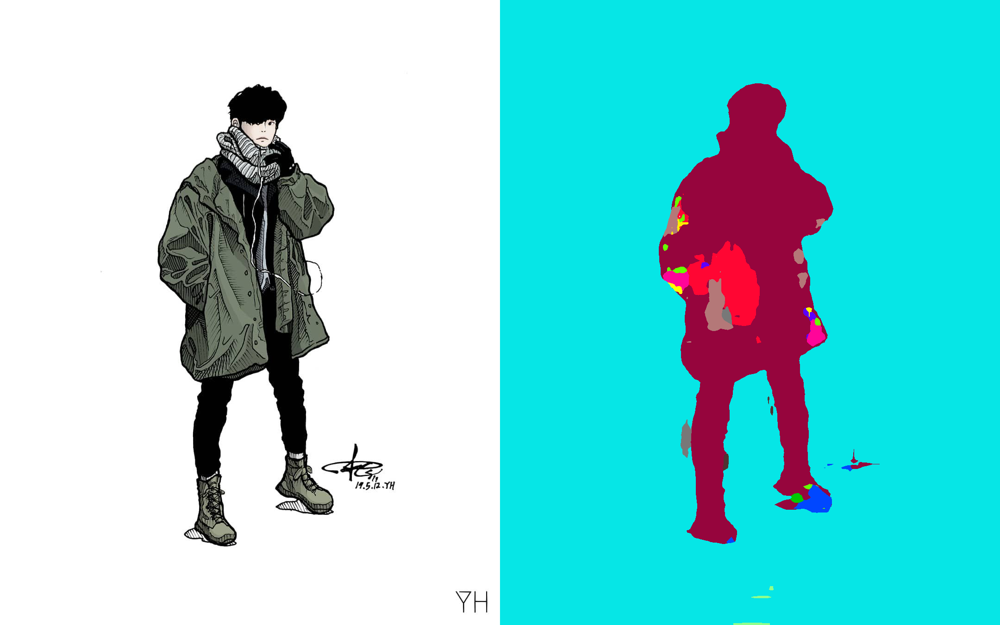

In [146]:
img6 = image.load_image('/content/drive/MyDrive/aiffel/EXP 10/draw_img2.jpg')
labels6 = semantic_segmentation.run(img6)
semantic_segmentation.visualize(img6, labels6)

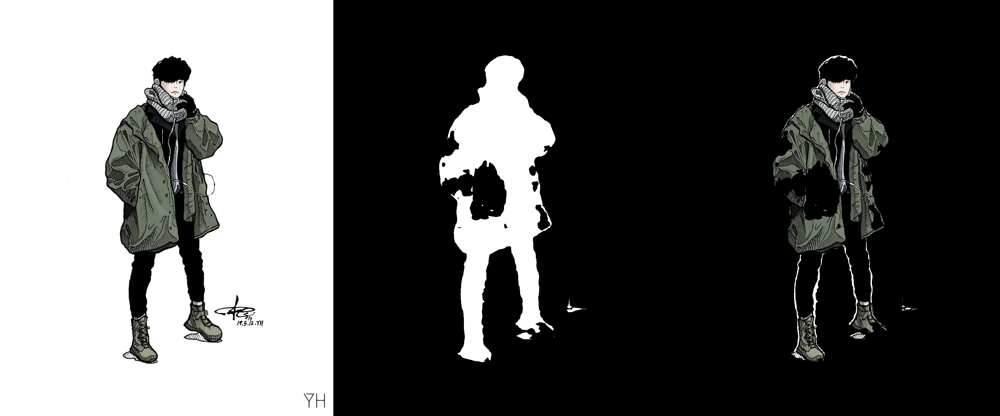

In [147]:
person_mask6 = semantic_segmentation.get_mask(labels6, index='person')
img_masked6 = mask.mask_image(person_mask6, img6)

all_images6 = image.concatenate_images([img6, person_mask6, img_masked6])
image.display(all_images6)

전신이 나오는 그림 이미지를 불러와 확인해본 값들이다.
결과적으로 그림 이미지에 대한 인식률은 떨어지는 것 같다.

--------

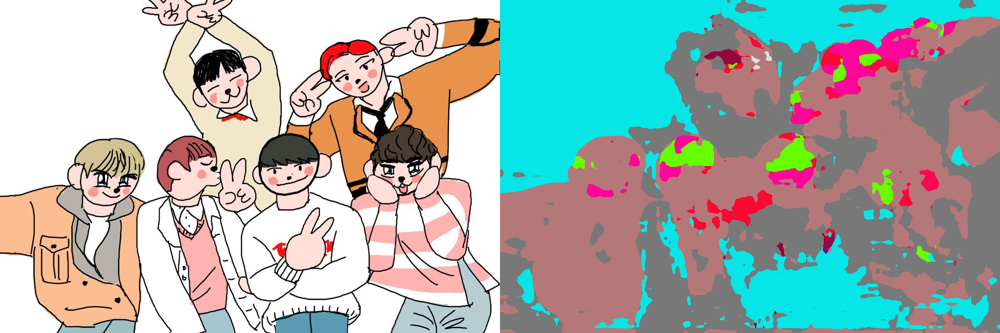

In [132]:
img4 = image.load_image('/content/drive/MyDrive/aiffel/EXP 10/draw_image_low.jpg')
labels4 = semantic_segmentation.run(img4)
semantic_segmentation.visualize(img4, labels4)

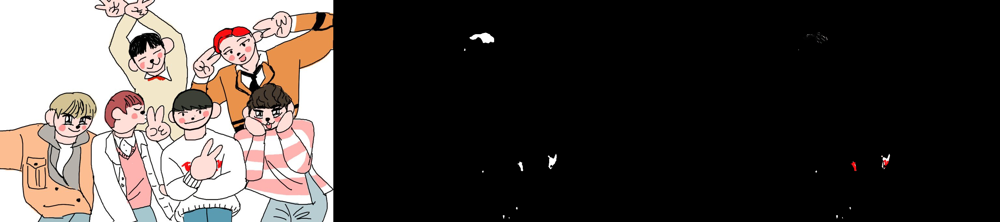

In [133]:
person_mask4 = semantic_segmentation.get_mask(labels4, index='person')
img_masked4 = mask.mask_image(person_mask4, img4)

all_images4 = image.concatenate_images([img4, person_mask4, img_masked4])
image.display(all_images4)

고퀄리티 이미지를 확인해 본 순간 안될걸 알았지만 확인을 해보았고  
역시나 인식을 못한다.

-----
# 8. 동물이미지 테스트
-----



루브릭 기준에서 동물(고양이) 사진을 해보라는 기준이 있어서 동물 사진을 테스트 해보려 하였으나   
현재 사용하는 모델인 ml4a는 동물의 라벨이 없어 이미지를 인식하지 못한다.  
때문에 아이펠 서버에서 pixellib를 활용해 동물 이미지를 확인해보고 결과값을 가져왔다.

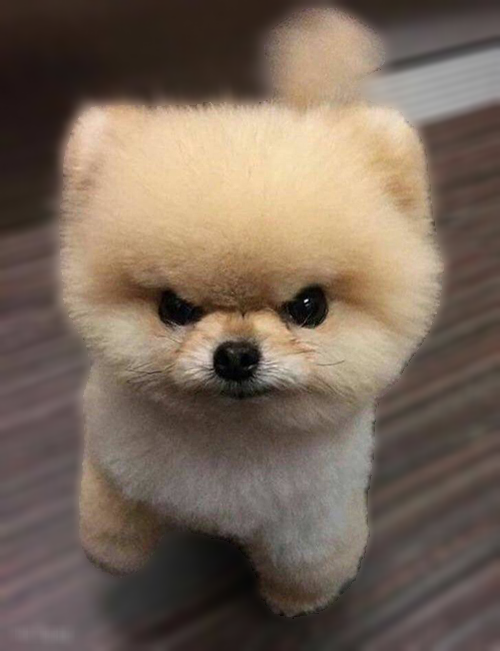

동물 이미지를 잘 인식하는 것을 확인할 수 있다.  
꼬리부분이 흐릿하게 보이는 것은 원본 이미지에서 흐리게 나오기 때문이며,  
외형을 인식하지 못해 블러처리하는 과정에서 같이 블러가 된 경우는 아니다.

-----
# 9. 오류 이미지 찾기
----

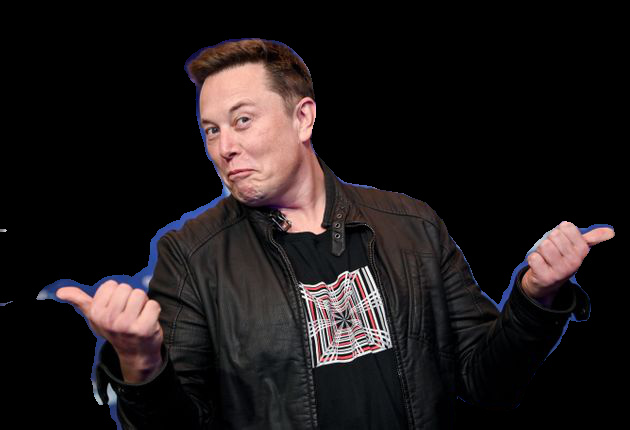

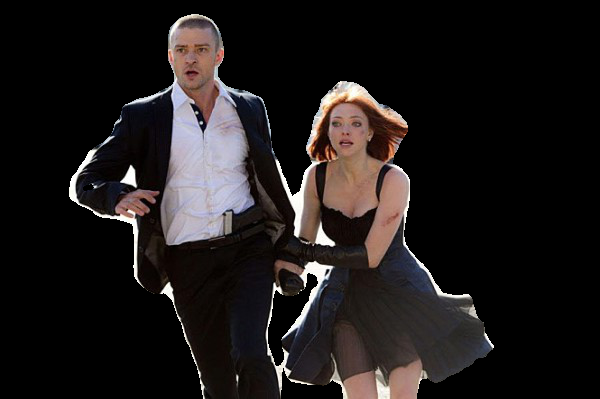

In [150]:
image.display(img_masked)
image.display(img_masked2)

pixellib이 아닌 ml4a 모델을 사용하였기 때문에 오류 이미지가 상대적으로 더 많이 보인다.  
누끼 라인이 인물에 밀접하게 나오는 것이 아닌, 일정 정도 거리를 두고 누끼 라인이 따지는 것은  
이미지를 합성하거나 활용하는데에 있어서 문제를 야기할 가능성이 있다고 판단된다.

-----
# 10. Solution
----

CV에서 가장 많이 다뤄지는 문제들은 

- Classification(분류)
  - 인풋에 대해 하나의 물체를 구분 (LeNet, AlexNet, VGG Nets, GooLeNet, ResNet, Xception 등의 모델)

- Object Detection (객체 탐지)
  - 물체 구분 + Boxing을 통한 위치 탐지 (RCNN, Fast RCNN, Faster RCNN, SPP Net, YOLO, SDD, Attention Net 등의 모델)

- Segmentation (분할)
  - 모든 픽셀에 대해 각 픽셀이 어떤 물체의 class인지 구분 (FCN, DeepLab, U-Net, ReSeg 등의 모델)

---------

-----
# 10-1. Segmentation의 이해
----

https://wooono.tistory.com/267

- FCN (Fully Convolutional networks)
  - 기존 모델은 conv층과 fully connected층으로 구성 (fully층은 차원을 줄이는 레이어)
  - 기존 분류용 CNN 모델의 문제는 입력 이미지를 네트워크에 맞는 고정된 사이즈로 작게 만들어서 입력을 해줘야 하며, 해당 모델들은 어떤 클래스에 있는지 예측은 가능하지만 parameter의 개수와 차원을 줄이는 Layer를 가지고 있어 위치정보를 잃는 문제점이 있다. 
  - 해당 문제를 해결하기 위해 ully connected 층을 1x1 convolution 층으로 바꿨다.
  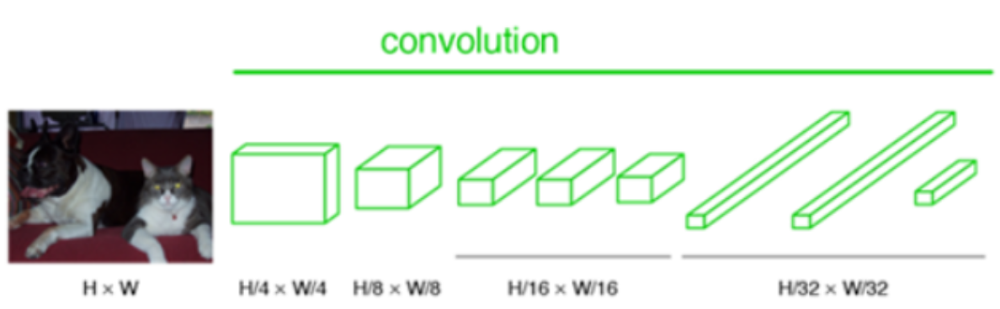
  - 이를통해 네트워크 전체가 conv층들로 이루어지며, 입력 이미지 크기에 제한을 받지 않게 된다.

---------

- U-Net
  - 네트워크 형태가 U와 비슷하여 붙여진 이름으로 의생명공학 이미지를 위해 개발된 모델 
  - 장점_1: 기존 Segmentation 모델의 단점인 느린 연산 속도를 개선
  - 장점_2: 기존 Patch에 따라서 Localization(객체의 위치 판단) 성능과 Context(인접 문맥 파악)의 Trade-Off 관계를 가졌으나,U-Net은 다층의 Layer의 Output을 동시에 검증해서 이러한 Trade-Off를 극복

    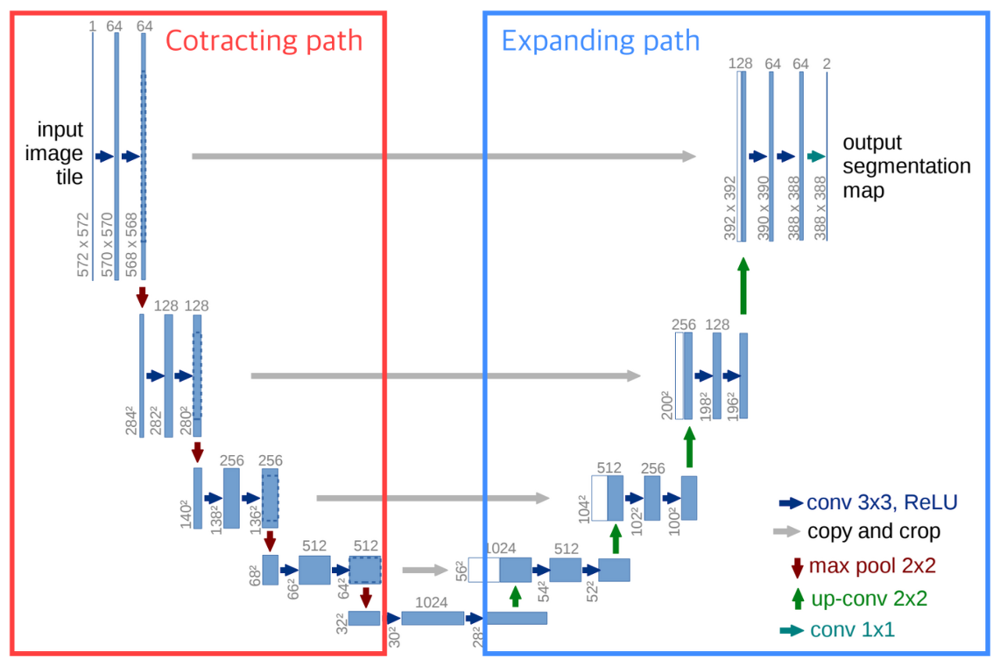
- Contracting Path
  - Contracting Path는 Encoder의 역할을 수행하는 부분으로 전형적인 Convolution Network로 구성
  - Contracting Path는 입력을 Feature Map으로 변형해 이미지의 Context를 파악
  - 이 경우에 Contracting Path의 앞단에 이미 잘 학습된 모델을 Backbone으로 사용해 학습 효율과 성능을 향상

- Expanding Path
  - Expanding Path는 Decoder의 역할을 수행하는 부분으로, 전형적인 Upsampling + Convolution Network로 구성
  - 즉, Convolution 연산을 거치기 전 Contracting Path에서 줄어든 사이즈를 다시 복원하는(Upsampling) 형태
  - Expanding Path에서는 Contracting을 통해 얻은 Feature Map을 Upsampling하고,
  - 각 Expanding 단계에 대응되는 Contracting 단계에서의 Feature Map과 결합해서 (Skip-Connection Concatenate) 더 정확한 Localization을 수행
  - 즉, Multi-Scale Object Segmentation을 위하여 Downsampling과 Upsampling을 순서대로 반복하는 구조입니다.

----------

- DeepLab V3+
  - V1에서는 atrous convolution을 적용
  - V2에서는 multi-scale context를 적용하기 위한 Atrous Spatial Pyramid Pooling (ASPP) 기법을 제안
  - V3에서는 기존 ResNet 구조에 atrous convolution을 활용해 좀 더 dense한 feature map을 얻는 방법을 제안
  - V3+에서는 separable convolution과 atrous convolution을 결합한 atrous separable convolution의 활용을 제안

- Atrous convolution
  - 필터 내부의 빈 공간을 둔 채로 작동 
  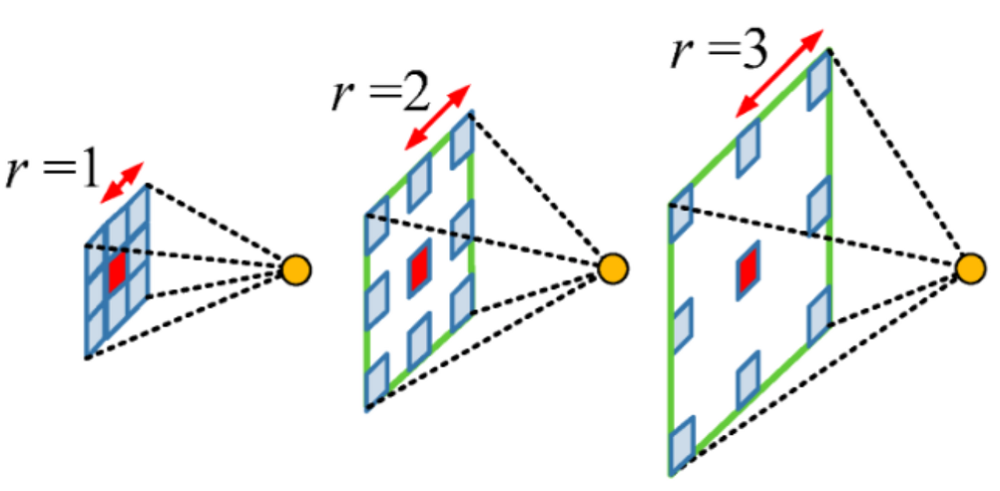

- Atrous Spatial Pyramid Pooling (ASPP) 
  - feature map으로부터, 여러 개의 rate가 다른 atrous convolution을 병렬로 적용한 뒤, 이를 다시 합쳐주는 atrous spatial pyramid pooling (ASPP) 기법을 활용
  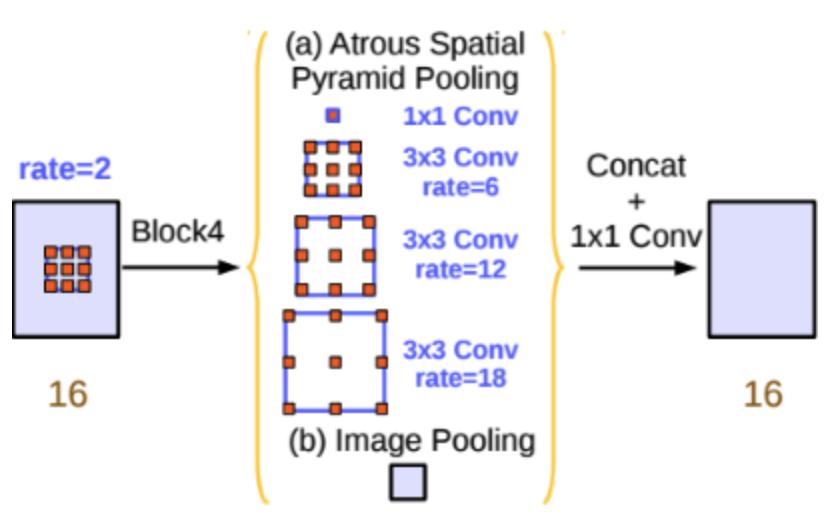

- Depthwise Separable Convolution
  - 입력 영상의 channel 축을 모두 분리시킨 뒤, filter의 channel 축 길이를 항상 1로 가지는 여러 개의 convolution filter로 대체시킨 연산
  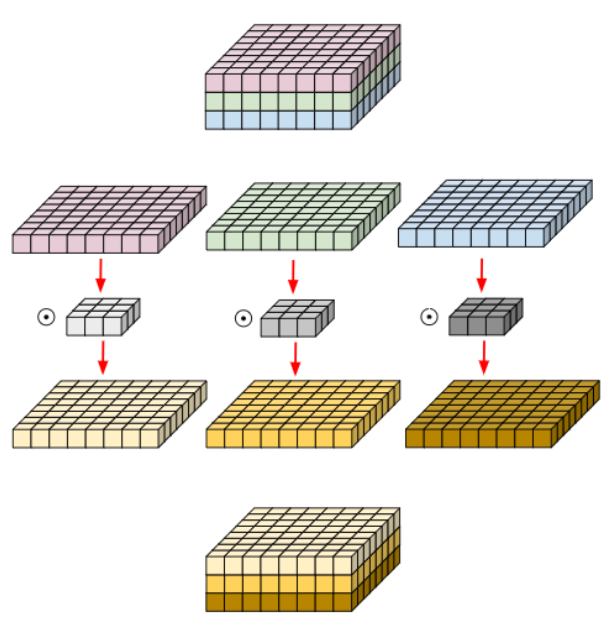

-----
# 10-2. 개선방안 고민해보기
----

https://www.koreascience.or.kr/article/JAKO202118350257336.pdf

- **해당 모델에 대한 이해도가 적어 생각나는 개선 방안이 없어서 인터넷을 찾다가 접한 개선방안 논문을 간략하게 리뷰하는 형식으로 진행하려 한다.**

- 한 논문에 의하면 U-Net의 경우 FCN과 비교하여 segmentation 정확도가 개선되었으나 U-Net은 인코더에서 추출 하는 context 정보가 부족하여 객체의 분할이 잘못되거나 실패하는 문제가 있다고 한다.  

- 문제를 해결하기 위해 residual learning을 활용한 인코더를 통해 특징 손실을 줄이고 context 정보를 효율적으로 추출하며, 인코더에서 down-sampling 연산을 줄여 특징 맵에 포함된 공간 정보의 손실을 개선할 수 있다고 한다.

- 먼저 Residual learning을 이용해 인코더로 활용하며, conv층을 기존 보다 약 3배 많게 설계하여 인코더의 context 정보 추출 능력을 개선하여 segmentation 정확도를 높였다고 한다.

- 디코더는 출력한 특징맵을 입력 이미지 크기로 확장 및 복원하는 과정으로 단순 보간법 또는 transposed conv로 확장하면 윤곽선과 같은 세밀한 부분을 복원할 수 없는 문제가 발생한다. 따라서 해당 논문에는 concatenation으로 인코더에서 추출된 중간 특징맵들을 활용해 문제를 개선하였다고 한다.

- 디코더의 상세 모델은 stride=2인 transposed conv로 특징맵을 2배 확장 한후 같은 해상도를 가진 인코더의 중간 특징맵을 concat한 후 결한된 특징맵에 3x3 conv, Batch normalization, ReLU를 2번 반복 수행하는 모델이다. 


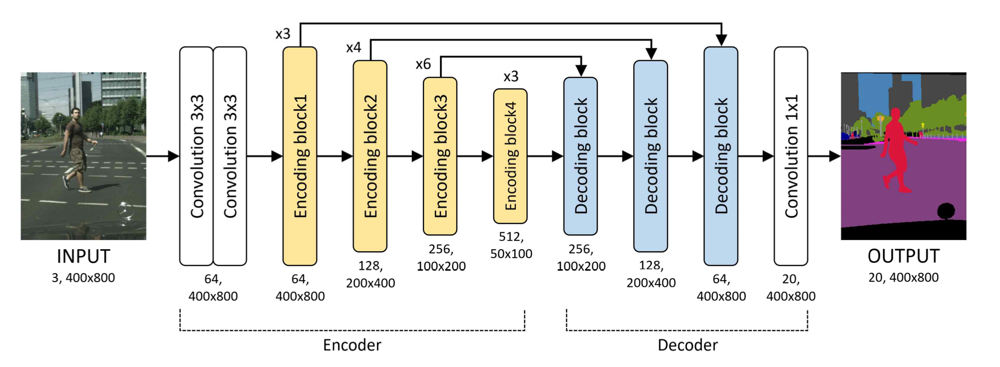

-----
# 11. 회고
-----



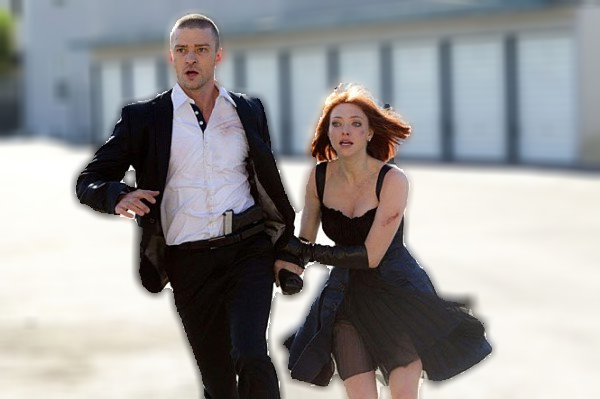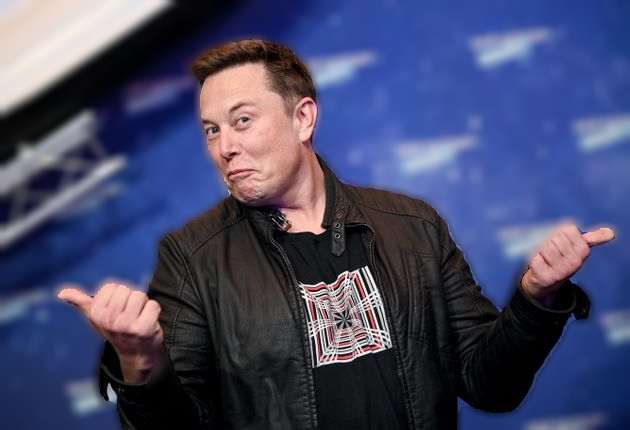

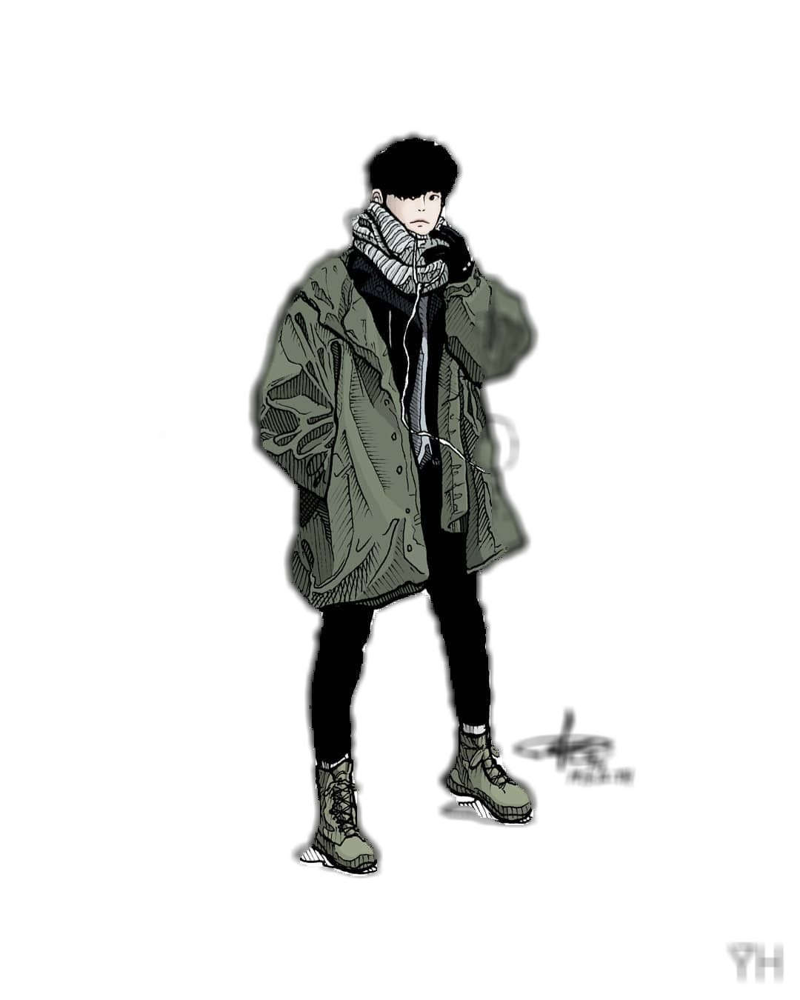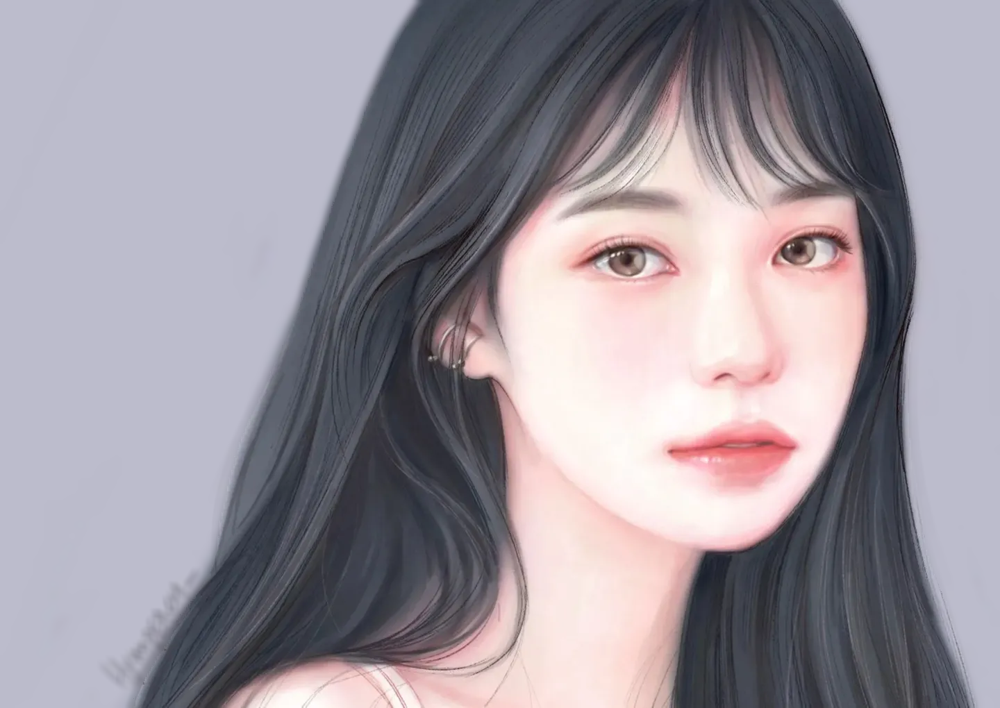

- colab에서 pixellib가 설치되지 않아 대용으로 ml4a를 사용하였다. 사용하면서 느낀 것이지만 ml4a가 더 pixellib보다 안좋은 모델이라는 느낌이 들었다.

- 위 4가지 이미지는 아이펠 서버에서 pixellib를 돌린 후 나온 이미지이다. 해당 이미지만 보아도 pixellib의 성능이 더 좋다는 것을 느낄 수 있었다.

- 그림 이미지 역시 ml4a에서는 안됐지만 pixellib에서는 잘 인식하고 결과값 또한 좋다.

- 목적에 따른 최신 혹은 좋은 모델을 찾고 활용하는 것의 중요성을 다시금 느낄 수 있었다.

- segmentation 관련 모델들을 찾아보면서 무수히 많은 layer의 결합 방식과 새로운 layer들이 많이 있다는 것을 알게 되었고, 알아야 할 것들이 너무 많다는 것에 두려움을 느꼈다.

- 모델 개선과 관련된 논문을 읽으며 한글 이지만 이해하지 못하는 한글 같은 느낌인 고전시가을 읽는 느낌이 었다. 추후에 분야를 정하고 관련 논문들을 많이 접해서 익숙해지는 방법 밖에는 없는 것 같다.